# Figure panels showing BAMBI performance and behavior

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from tqdm.auto import tqdm
from aging.plotting import (
    figure,
    format_plots,
    add_identity,
    legend,
    PLOT_CONFIG,
    save_factory,
)

from sklearn.svm import SVR
from sklearn.pipeline import make_pipeline
from sklearn.decomposition import PCA
from sklearn.linear_model import ElasticNet
from sklearn.preprocessing import StandardScaler
from sklearn.cross_decomposition import PLSRegression
from sklearn.metrics import r2_score, mean_absolute_error
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.model_selection import cross_val_predict, KFold, ParameterGrid, LeaveOneOut
from sklearn.inspection import permutation_importance
# KKN regressor

In [2]:
format_plots()
saver = save_factory(PLOT_CONFIG.save_path / "fig2-bambi", tight_layout=False)

In [3]:
def zscore(ser: pd.Series):
    return (ser - ser.mean()) / ser.std()


def demean(ser: pd.Series):
    return ser - ser.mean()


def quantile(n):
    def percentile_(x):
        return x.quantile(n)
    percentile_.__name__ = 'q_{:0.02f}'.format(n)
    return percentile_


## Show methylation fits

In [ ]:
bio_age_samples = pd.read_parquet('/n/scratch/users/w/wg41/bio-age-model/ontogeny-predictions.parquet')

meth_df = pd.read_parquet(
    "/n/groups/datta/win/longtogeny/data/epigenetics/analysis/epi_df.parquet"
)

meth_df = meth_df.astype(float).sort_index(level='age')

beh_reindexed = bio_age_samples.loc[pd.IndexSlice[:, :, :, :, meth_df.index.get_level_values('uuid')], :].copy()
beh_reindexed = pd.DataFrame(beh_reindexed.mean(1).rename('bio_age'))
age = beh_reindexed.index.get_level_values('age')

In [7]:
resid = beh_reindexed.groupby('age').rank()
resid = resid.groupby('age').transform(zscore)
# resid = zscore(resid.to_numpy())

In [8]:
bio_age = beh_reindexed['bio_age']
age_map = age.unique()
age_map = dict(enumerate(age_map))
remapped_bio_age = pd.qcut(bio_age, 6, labels=False).map(age_map)
age_map

{0: 4, 1: 8, 2: 12, 3: 52, 4: 78, 5: 90}

In [10]:
keep_genes = meth_df.std() > 0.05
keep_genes = keep_genes.index[keep_genes]
filt_meth_df = meth_df[keep_genes]

### Fit to age

In [90]:
# probably takes way too long
# p_imp = permutation_importance(
#     pipeline, train_df, train_y, n_repeats=10, random_state=0, n_jobs=-1
# )

In [62]:
pipeline = make_pipeline(
    StandardScaler(),
    GradientBoostingRegressor(),
)

scores = []
for i in tqdm(range(15)):
    _score = r2_score(
        age,
        cross_val_predict(
            pipeline,
            meth_df,
            age,
            # cv=LeaveOneOut(),
            cv=KFold(n_splits=8, random_state=i, shuffle=True),
            n_jobs=-1,
        ).squeeze(),
    )
    scores.append(_score)
    print(_score)

  0%|          | 0/15 [00:00<?, ?it/s]

0.9294354006835792


KeyboardInterrupt: 

In [121]:
def run_predictions(pipeline, X, y, random_state=0):
    true = []
    importances = []
    pred = []

    kfold = KFold(n_splits=8, shuffle=True, random_state=random_state)
    for train, test in tqdm(kfold.split(X), total=8):
        train_df = X.iloc[train]
        test_df = X.iloc[test]

        train_y = y[train]
        test_y = y[test]

        pipeline.fit(train_df, train_y)

        pred.extend(pipeline.predict(test_df))
        true.extend(test_y)

        gbr = pipeline.steps[1][1]
        importances.append(gbr.feature_importances_)
        print((importances[-1] > 0).sum())
        print((np.sum(importances, axis=0) > 0).sum())
        print(f"{r2_score(true, pred):0.2f}")
        print('-' * 5)
    return importances, true, pred

In [122]:
pipeline = make_pipeline(
    StandardScaler(),
    GradientBoostingRegressor(
        max_depth=3,
        max_features=0.25,
        min_samples_split=4,
        min_samples_leaf=3,
        random_state=0,
    ),
)

true = []
pred = []
importances = []

_imp, _true, _pred = run_predictions(pipeline, meth_df, age, random_state=0)

true.extend(_true)
pred.extend(_pred)
importances.extend(_imp)

_imp, _true, _pred = run_predictions(pipeline, meth_df, age, random_state=1)
true.extend(_true)
pred.extend(_pred)
importances.extend(_imp)

importances = np.array(importances)

  0%|          | 0/8 [00:00<?, ?it/s]

499
499
0.87
-----
498
890
0.89
-----
499
1214
0.84
-----
496
1500
0.88
-----
463
1721
0.90
-----
495
1921
0.92
-----
463
2197
0.93
-----
455
2527
0.90
-----


  0%|          | 0/8 [00:00<?, ?it/s]

499
499
0.93
-----
495
850
0.69
-----
496
1137
0.85
-----
496
1399
0.87
-----
498
1613
0.85
-----
498
1801
0.87
-----
499
2127
0.87
-----
499
2317
0.88
-----


In [123]:
r2_score(true, pred)

0.8896236952873064

In [129]:
# importances = np.vstack(importances)

In [130]:
sort_idx = np.argsort(np.mean(importances, axis=0))[::-1]

In [131]:
(importances > 0).sum(1)

array([499, 498, 499, 496, 463, 495, 463, 455, 499, 495, 496, 496, 498,
       498, 499, 499])

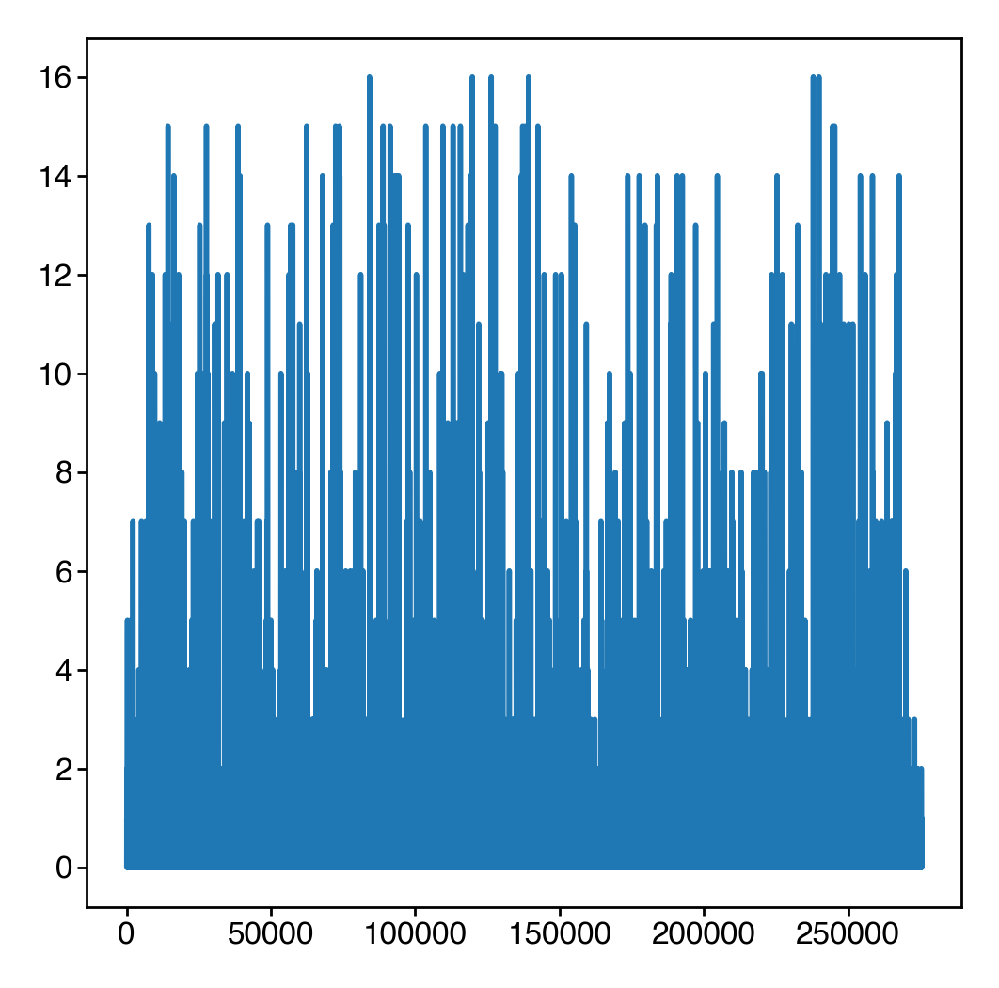

In [132]:
plt.plot((importances > 0).sum(0))

In [133]:
inds = np.where(importances.sum(0) > 0)[0]
len(inds)

3601

/home/wg41/miniconda3/envs/aging-gpu/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/wg41/miniconda3/envs/aging-gpu/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


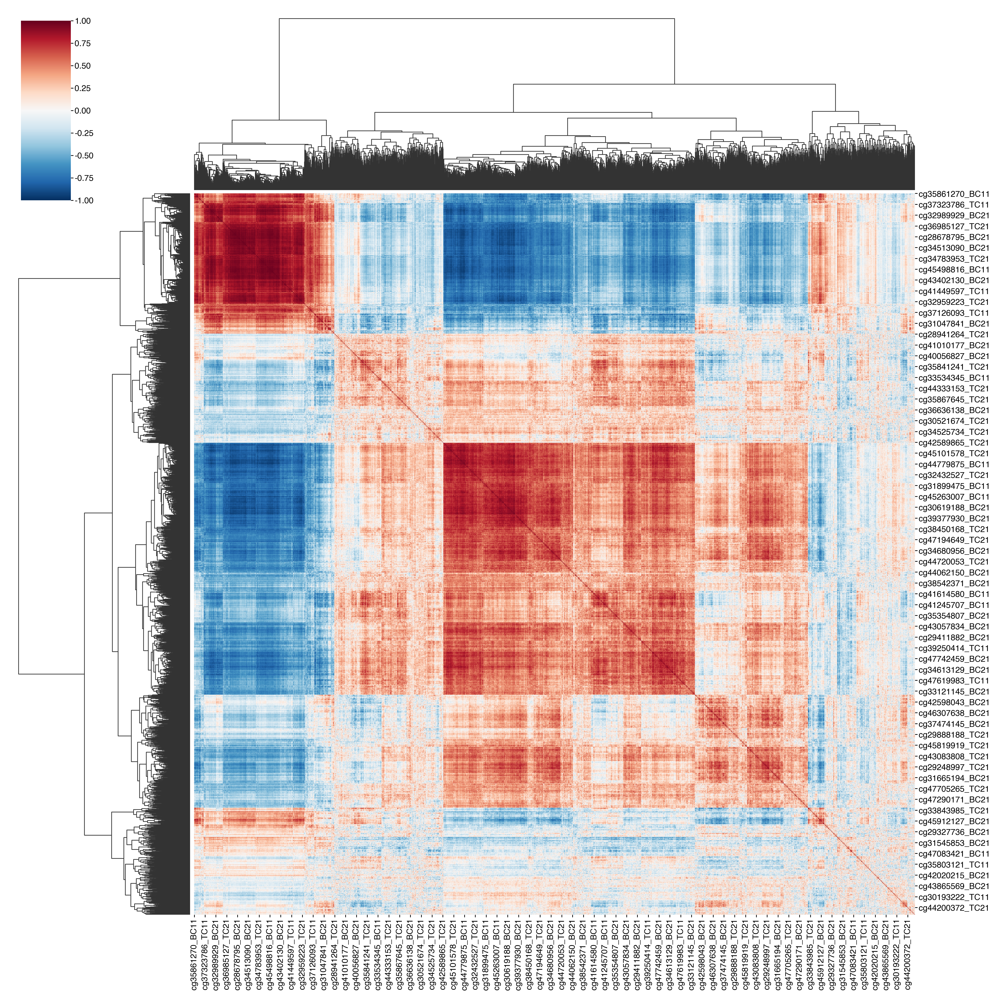

In [134]:
sns.clustermap(meth_df[meth_df.columns[inds]].corr(), cmap='RdBu_r', vmin=-1, vmax=1)

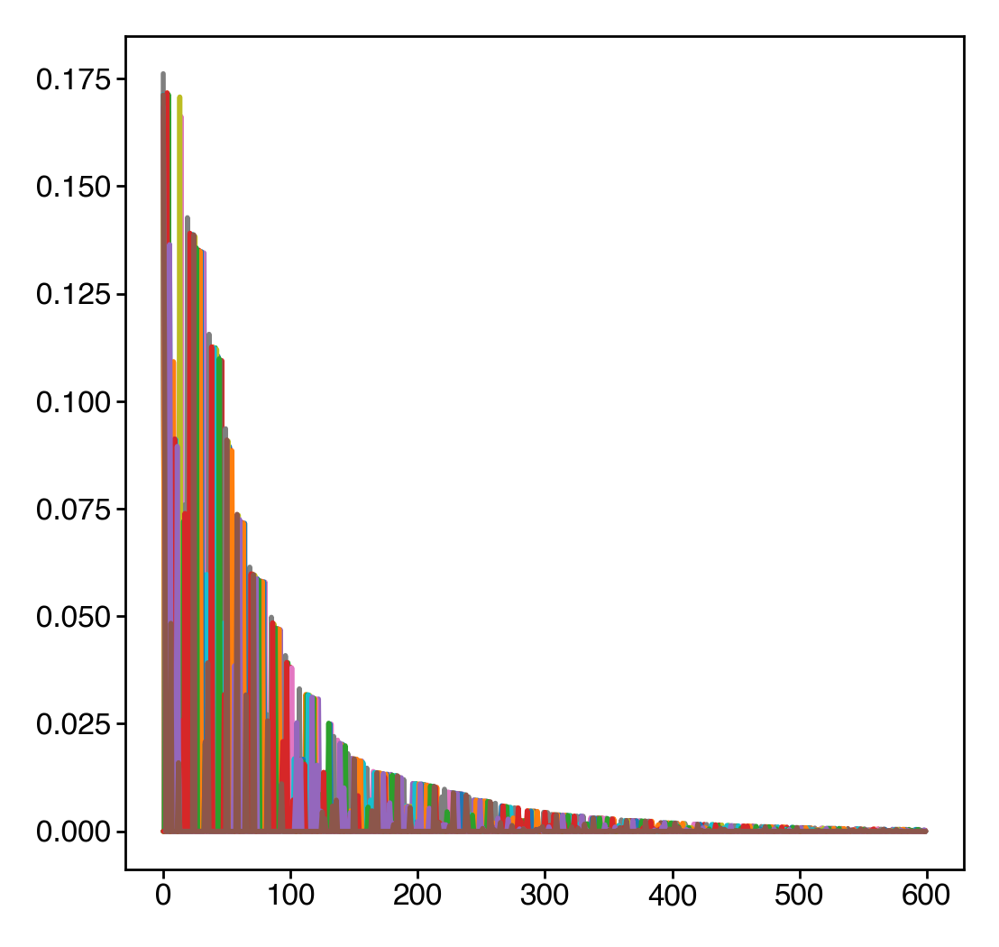

In [135]:
plt.plot(importances[:, sort_idx[:600]].T)

In [136]:
pipeline = make_pipeline(
    StandardScaler(),
    GradientBoostingRegressor(),
)

scores = []
for i in tqdm(range(10)):
    _score = r2_score(
        age,
        cross_val_predict(
            pipeline,
            meth_df[meth_df.columns[inds]],
            age,
            # cv=LeaveOneOut(),
            cv=KFold(n_splits=8, random_state=i, shuffle=True),
            n_jobs=-1,
        ).squeeze(),
    )
    scores.append(_score)
    print(_score)

  0%|          | 0/15 [00:00<?, ?it/s]

0.9607308173754612
0.9678135585964505
0.9355951452858642
0.9668423724170794
0.9339427653916919
0.9540374734845323
0.9579391555363241
0.9558514228351361
0.9689735087951896
0.9639286705524873
0.9412573685347486
0.9255528376146025
0.9311402729197248
0.9586229091821074
0.9439099742236192


### Fit to beh age

In [8]:
bio_age = beh_reindexed['bio_age']
age_map = age.unique()
age_map = dict(enumerate(age_map))
remapped_bio_age = pd.qcut(bio_age, 6, labels=False).map(age_map)
age_map

{0: 4, 1: 8, 2: 12, 3: 52, 4: 78, 5: 90}

In [172]:
pipeline = make_pipeline(
    StandardScaler(),
    GradientBoostingRegressor(
        max_depth=3,
        max_features=0.25,
        min_samples_split=4,
        min_samples_leaf=3,
        random_state=0,
    ),
)

bio_true = []
bio_pred = []
bio_importances = []

# _imp, _true, _pred = run_predictions(pipeline, meth_df, bio_age.to_numpy(), random_state=0)
_imp, _true, _pred = run_predictions(pipeline, meth_df, remapped_bio_age.to_numpy(), random_state=0)

bio_true.extend(_true)
bio_pred.extend(_pred)
bio_importances.extend(_imp)

# _imp, _true, _pred = run_predictions(pipeline, meth_df, bio_age.to_numpy(), random_state=1)
_imp, _true, _pred = run_predictions(pipeline, meth_df, remapped_bio_age.to_numpy(), random_state=1)

bio_true.extend(_true)
bio_pred.extend(_pred)
bio_importances.extend(_imp)

bio_importances = np.array(bio_importances)

  0%|          | 0/8 [00:00<?, ?it/s]

495
495
0.94
-----
498
850
0.90
-----
497
1119
0.87
-----
497
1387
0.88
-----
495
1584
0.91
-----
497
1790
0.91
-----
463
2054
0.92
-----
453
2399
0.92
-----


  0%|          | 0/8 [00:00<?, ?it/s]

497
497
0.99
-----
432
890
0.67
-----
496
1194
0.83
-----
497
1453
0.87
-----
432
1790
0.88
-----
497
1969
0.89
-----
496
2293
0.90
-----
499
2488
0.90
-----


In [173]:
bio_inds = np.where(bio_importances.sum(0) > 0)[0]
len(bio_inds)

3819

In [175]:
pipeline = make_pipeline(
    StandardScaler(),
    GradientBoostingRegressor(),
)

scores = []
for i in tqdm(range(15)):
    _score = r2_score(
        remapped_bio_age,
        cross_val_predict(
            pipeline,
            meth_df[meth_df.columns[bio_inds]],
            remapped_bio_age,
            # cv=LeaveOneOut(),
            cv=KFold(n_splits=8, random_state=i, shuffle=True),
            n_jobs=-1,
        ).squeeze(),
    )
    scores.append(_score)
    print(_score)

  0%|          | 0/15 [00:00<?, ?it/s]

0.954180560792137
0.938169613670533
0.9512631348431747
0.9566034987746769
0.9403820894561529
0.9473397574573538
0.9396140278129151
0.9246151619922875
0.9270174090622199
0.9321238351132051
0.9212788798560639
0.9367118535606207
0.9464821076071418
0.9601938663020785
0.9264908629903796


In [176]:
pipeline = make_pipeline(
    StandardScaler(),
    GradientBoostingRegressor(),
)

scores = []
for i in tqdm(range(15)):
    _score = r2_score(
        remapped_bio_age,
        cross_val_predict(
            pipeline,
            meth_df[meth_df.columns[inds]],
            remapped_bio_age,
            # cv=LeaveOneOut(),
            cv=KFold(n_splits=8, random_state=i, shuffle=True),
            n_jobs=-1,
        ).squeeze(),
    )
    scores.append(_score)
    print(_score)

  0%|          | 0/15 [00:00<?, ?it/s]

0.9206117854765121
0.9398638186260676
0.9556928253190208
0.905207838046168
0.9428320894479402
0.9374071314987441
0.9018932781905361
0.9371428827093482
0.9338047496912558
0.924811713152459
0.9208911164207835
0.943093652280129
0.9390025924212855
0.9241432111357408
0.9276588092396604


In [144]:
pipeline = make_pipeline(
    StandardScaler(),
    GradientBoostingRegressor(),
)

scores = []
for i in tqdm(range(15)):
    _score = r2_score(
        age,
        cross_val_predict(
            pipeline,
            meth_df[meth_df.columns[bio_inds]],
            age,
            # cv=LeaveOneOut(),
            cv=KFold(n_splits=8, random_state=i, shuffle=True),
            n_jobs=-1,
        ).squeeze(),
    )
    scores.append(_score)
    print(_score)

  0%|          | 0/15 [00:00<?, ?it/s]

0.9123247500192495
0.9173757150633581
0.9327249772776693
0.9283262935136636
0.9462464883433221
0.9390597073921798
0.9120776590200108
0.9363010338333979
0.9319202342179741
0.9272724199207371
0.9301015088910256
0.9159704718362198
0.9336893523083927
0.9354811295790764
0.9210313369266061


### Fit to residuals

In [58]:
pipeline = make_pipeline(
    StandardScaler(),
    GradientBoostingRegressor(),
    # SVR(kernel='linear'),
    # RandomForestRegressor(),
    # ElasticNet(alpha=1e-1, l1_ratio=0.1),
)

params = {
    # 'svr__C': np.logspace(-6, 1, 11),
    'elasticnet__l1_ratio': np.linspace(0.1, 1, 6),
    'elasticnet__alpha': np.logspace(-3, 0, 8),
}

grid = ParameterGrid(params)

In [151]:
scores = []
for i in range(10):
    _score = r2_score(
        resid.squeeze(),
        cross_val_predict(
            pipeline,
            # meth_df[meth_df.columns[inds]],
            meth_df[meth_df.columns[list(set(np.concatenate([bio_inds, inds])))]],
            # filt_meth_df,
            resid.squeeze(),
            # cv=LeaveOneOut(),
            cv=KFold(n_splits=8, random_state=i, shuffle=True),
            n_jobs=-1,
        ).squeeze(),
    )
    scores.append(_score)
    print(_score)

-1.0784553804089256
-1.1660802013515599
-1.3065817165753115
-1.5799875981755798
-1.314804061437901
-1.0106479728687807
-0.9849011871483988
-1.0347438595899772
-1.332942438517164
-1.0370327959673067


[Text(0, 0.5, 'Heldout r2')]

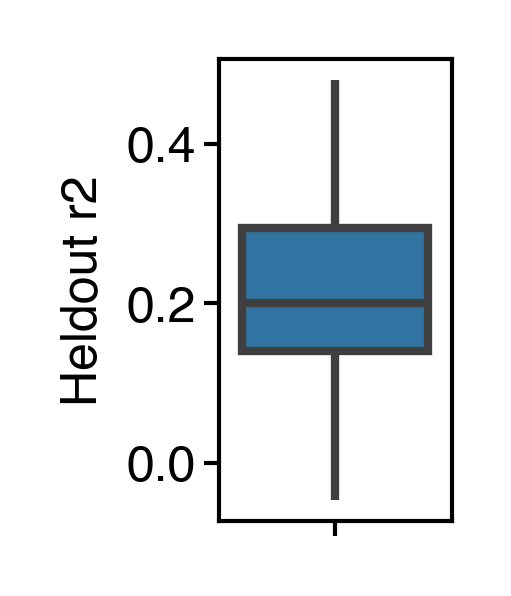

In [23]:
fig = figure(0.5, 1)
ax = sns.boxplot(scores, showfliers=False, showcaps=False)
ax.set(ylabel="Heldout r2")


## Use features from each group to predict the other groups

In [15]:
z_age = zscore(age.to_numpy())
z_bio_age = zscore(remapped_bio_age.to_numpy())

In [194]:
pipeline = make_pipeline(
    StandardScaler(),
    ElasticNet(max_iter=10_000),
)

params = {
    'elasticnet__l1_ratio': np.linspace(0, 1, 4),
    'elasticnet__alpha': np.logspace(-3, 0, 6),
}

grid = ParameterGrid(params)

In [197]:
out = []
for param_set in tqdm(list(grid)):
    pipeline.set_params(**param_set)
    _score = r2_score(
        z_age,
        cross_val_predict(
            pipeline.set_params(**param_set),
            filt_meth_df,
            z_age,
            cv=KFold(n_splits=8, shuffle=True, random_state=0),
            n_jobs=-1,
        ).squeeze(),
    )
    param_set['score'] = _score
    print(param_set)
    out.append(param_set)
out = pd.DataFrame(out)

  0%|          | 0/30 [00:00<?, ?it/s]

{'elasticnet__alpha': 0.001, 'elasticnet__l1_ratio': 0.1, 'score': 0.978031583705205}
{'elasticnet__alpha': 0.001, 'elasticnet__l1_ratio': 0.325, 'score': 0.9695302296525358}
{'elasticnet__alpha': 0.001, 'elasticnet__l1_ratio': 0.55, 'score': 0.9676559483899028}
{'elasticnet__alpha': 0.001, 'elasticnet__l1_ratio': 0.775, 'score': 0.9698479866018873}
{'elasticnet__alpha': 0.001, 'elasticnet__l1_ratio': 1.0, 'score': 0.972299103766148}
{'elasticnet__alpha': 0.003981071705534973, 'elasticnet__l1_ratio': 0.1, 'score': 0.9816353177422059}
{'elasticnet__alpha': 0.003981071705534973, 'elasticnet__l1_ratio': 0.325, 'score': 0.9795442840127426}
{'elasticnet__alpha': 0.003981071705534973, 'elasticnet__l1_ratio': 0.55, 'score': 0.9755151495407116}
{'elasticnet__alpha': 0.003981071705534973, 'elasticnet__l1_ratio': 0.775, 'score': 0.9788471283253989}
{'elasticnet__alpha': 0.003981071705534973, 'elasticnet__l1_ratio': 1.0, 'score': 0.9734395535690294}
{'elasticnet__alpha': 0.015848931924611134, 'el

Process LokyProcess-52:


KeyboardInterrupt: 

### Fit enet to age

In [12]:
# selected parameters
pipeline = make_pipeline(
    StandardScaler(),
    ElasticNet(max_iter=10_000, alpha=1e-3, l1_ratio=0.5),
)

In [13]:
# doesn't make sense because of data leakage
# pipeline.fit(meth_df, z_age)
# c = pipeline.named_steps['elasticnet'].coef_

# inds = np.where(c != 0)[0]
# len(inds)

In [16]:
age_age_scores = []
for i in range(10):
    _score = r2_score(
        z_age,
        cross_val_predict(
            pipeline,
            # meth_df[meth_df.columns[inds]],
            meth_df,
            z_age,
            cv=KFold(n_splits=8, random_state=i, shuffle=True),
            n_jobs=-1,
        ).squeeze(),
    )
    age_age_scores.append(_score)
    print(_score)

0.9712144234529683
0.976958678745107
0.9726595350626024
0.964189160387038
0.9733156884010984
0.9689844615191856
0.9742185543242775
0.9781097378905279
0.9777562618388653
0.9726870723836382


In [17]:
# age_bio_age_scores = []
# for i in range(10):
#     _score = r2_score(
#         z_bio_age,
#         cross_val_predict(
#             pipeline,
#             meth_df[meth_df.columns[inds]],
#             z_bio_age,
#             cv=KFold(n_splits=8, random_state=i, shuffle=True),
#             n_jobs=-1,
#         ).squeeze(),
#     )
#     age_bio_age_scores.append(_score)
#     print(_score)

### Fit enet to bio age

In [18]:
# pipeline.fit(meth_df, z_bio_age)
# c = pipeline.named_steps['elasticnet'].coef_
# bio_inds = np.where(c != 0)[0]
# len(bio_inds)

In [19]:
bio_age_bio_age_scores = []
for i in range(10):
    _score = r2_score(
        z_bio_age,
        cross_val_predict(
            pipeline,
            # meth_df[meth_df.columns[bio_inds]],
            meth_df,
            z_bio_age,
            cv=KFold(n_splits=8, random_state=i, shuffle=True),
            n_jobs=-1,
        ).squeeze(),
    )
    bio_age_bio_age_scores.append(_score)
    print(_score)

0.950596818730274
0.9633061671561933
0.9573630359586047
0.95417298956541
0.9459290487332099
0.9461359555096783
0.9519334238649629
0.9667367242980097
0.9595487984070573
0.9618725135043616


In [20]:
# bio_age_age_scores = []
# for i in range(10):
#     _score = r2_score(
#         z_age,
#         cross_val_predict(
#             pipeline,
#             meth_df[meth_df.columns[bio_inds]],
#             z_age,
#             cv=KFold(n_splits=8, random_state=i, shuffle=True),
#             n_jobs=-1,
#         ).squeeze(),
#     )
#     bio_age_age_scores.append(_score)
#     print(_score)

### Plot results

In [ ]:
fig = figure(0.5, 1)
ax = sns.violinplot(data=[age_age_scores, bio_age_bio_age_scores], palette=['lightgray', 'gray'])
ax.set(xticklabels=["Chron. age", "Beh. age"], ylabel="Heldout R2")
plt.xticks(rotation=90)
sns.despine()
saver(fig, "methylation-heldout-r2");

/tmp/ipykernel_15617/2610755419.py:3: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set(xticklabels=["Chron. age", "Beh. age"], ylabel="Heldout R2")


### Fit enet to residuals - find features

In [256]:
pipeline.fit(meth_df, resid['bio_age'].to_numpy())
c = pipeline.named_steps['elasticnet'].coef_
resid_inds = np.where(c != 0)[0]
len(resid_inds)

53

In [11]:
resid_scores = []
for i in range(10):
    _score = r2_score(
        resid['bio_age'].to_numpy(),
        cross_val_predict(
            pipeline,
            # meth_df[meth_df.columns[resid_inds]],
            meth_df,
            resid['bio_age'].to_numpy(),
            cv=KFold(n_splits=12, random_state=i, shuffle=True),
            n_jobs=-1,
        ).squeeze(),
    )
    resid_scores.append(_score)
    print(_score)

-0.06622119036101282
0.023720362433075404
0.0361763004829635


KeyboardInterrupt: 

In [258]:
resid_age_scores = []
for i in range(10):
    _score = r2_score(
        z_age,
        cross_val_predict(
            pipeline,
            meth_df[meth_df.columns[resid_inds]],
            z_age,
            cv=KFold(n_splits=8, random_state=i, shuffle=True),
            n_jobs=-1,
        ).squeeze(),
    )
    resid_age_scores.append(_score)
    print(_score)

0.6935501401894673
0.6443563747703644
0.7046029900397828
0.767718069074132
0.5933745803556079
0.5067549281916286
0.6896733702553576
0.7232246254153265
0.5450567244702593
0.6990857563140112


In [259]:
resid_bio_age_scores = []
for i in range(10):
    _score = r2_score(
        z_bio_age,
        cross_val_predict(
            pipeline,
            meth_df[meth_df.columns[resid_inds]],
            z_bio_age,
            cv=KFold(n_splits=8, random_state=i, shuffle=True),
            n_jobs=-1,
        ).squeeze(),
    )
    resid_bio_age_scores.append(_score)
    print(_score)

0.6248075799049086
0.5519628969016845
0.6566470133551989
0.6474082994057204
0.5387790527129719
0.45184857188932337
0.647449437339698
0.6990338557071858
0.42165931779027777
0.486697260016121


In [260]:
np.mean(resid_bio_age_scores)

0.5726293285023091

In [261]:
np.mean(resid_age_scores)

0.6567397559075937